# Autotalker Data Analysis

- **Creator**: Sebastian Birk (<sebastian.birk@helmholtz-munich.de>).
- **Affiliation:** Helmholtz Munich, Institute of Computational Biology (ICB), Talavera-López Lab
- **Date of Creation:** 22.01.2023
- **Date of Last Modification:** 27.01.2023

## 1. Setup

### 1.1 Import Libraries

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append("../../autotalker")

In [3]:
import argparse
import os
import random
import warnings
from copy import deepcopy
from datetime import datetime

import anndata as ad
import matplotlib
import matplotlib.pyplot as plt
import mlflow
import numpy as np
import pandas as pd
import scanpy as sc
import scipy.sparse as sp
import seaborn as sns
import squidpy as sq
import torch
from matplotlib.pyplot import rc_context

from autotalker.models import Autotalker
from autotalker.utils import (add_gps_from_gp_dict_to_adata,
                              extract_gp_dict_from_mebocost_es_interactions,
                              extract_gp_dict_from_nichenet_ligand_target_mx,
                              extract_gp_dict_from_omnipath_lr_interactions,
                              filter_and_combine_gp_dict_gps)

### 1.2 Define Parameters

In [4]:
## Dataset
dataset = "seqfish_mouse_organogenesis"
batch1 = "embryo1_z2"
batch2 = "embryo1_z5"
batch3 = "embryo2_z2"
batch4 = "embryo2_z5"
batch5 = "embryo3_z2"
batch6 = "embryo3_z5"
n_neighbors = 4 # 12

## Model
# AnnData Keys
counts_key = "counts"
cell_type_key = "celltype_mapped_refined"
adj_key = "spatial_connectivities"
spatial_key = "spatial"
gp_names_key = "autotalker_gp_names"
active_gp_names_key = "autotalker_active_gp_names"
gp_targets_mask_key = "autotalker_gp_targets"
gp_sources_mask_key = "autotalker_gp_sources"
latent_key = "autotalker_latent"
condition_key = "batch"

# Architecture
active_gp_thresh_ratio = 0.03
gene_expr_recon_dist = "nb"
n_cond_embed = 3

# Trainer
n_epochs = 40
n_epochs_all_gps = 20
lr = 0.001
lambda_edge_recon = 0.005 # 0.001 for 12 neighbors
lambda_gene_expr_recon = 0.00165 # 0.00033 for 12 neighbors

## Others
random_seed = 42
load_timestamp = None

### 1.3 Run Notebook Setup

In [5]:
sc.set_figure_params(figsize=(6, 6))
sns.set_style("whitegrid", {'axes.grid' : False})

In [6]:
# Ignore future warnings and user warnings
warnings.simplefilter(action="ignore", category=FutureWarning)
warnings.simplefilter(action="ignore", category=UserWarning)

In [7]:
# Get time of notebook execution for timestamping saved artifacts
now = datetime.now()
current_timestamp = now.strftime("%d%m%Y_%H%M%S")

### 1.4 Configure Paths and Create Directories

In [8]:
# Define paths
figure_folder_path = f"../figures/{dataset}/analysis/{current_timestamp}"
model_artifacts_folder_path = f"../artifacts/{dataset}/analysis/{current_timestamp}"
gp_data_folder_path = "../datasets/gp_data" # gene program data
srt_data_folder_path = "../datasets/srt_data" # spatially resolved transcriptomics data
srt_data_gold_folder_path = f"{srt_data_folder_path}/gold"
nichenet_ligand_target_mx_file_path = gp_data_folder_path + "/nichenet_ligand_target_matrix.csv"
omnipath_lr_interactions_file_path = gp_data_folder_path + "/omnipath_lr_interactions.csv"

# Create required directories
os.makedirs(figure_folder_path, exist_ok=True)
os.makedirs(model_artifacts_folder_path, exist_ok=True)

## 2. Data

### 2.1 Load Data & Compute Spatial Neighbor Graph

In [73]:
adata_imputed = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_imputed.h5ad")

In [76]:
adata_imputed.obs_names

Index(['embryo1_Pos0_cell100_z2', 'embryo1_Pos0_cell101_z2',
       'embryo1_Pos0_cell102_z2', 'embryo1_Pos0_cell103_z2',
       'embryo1_Pos0_cell105_z2', 'embryo1_Pos0_cell106_z2',
       'embryo1_Pos0_cell107_z2', 'embryo1_Pos0_cell109_z2',
       'embryo1_Pos0_cell110_z2', 'embryo1_Pos0_cell111_z2',
       ...
       'embryo3_Pos39_cell83_z5', 'embryo3_Pos39_cell85_z5',
       'embryo3_Pos39_cell87_z5', 'embryo3_Pos39_cell88_z5',
       'embryo3_Pos39_cell9_z5', 'embryo3_Pos39_cell90_z5',
       'embryo3_Pos39_cell93_z5', 'embryo3_Pos39_cell95_z5',
       'embryo3_Pos39_cell96_z5', 'embryo3_Pos39_cell98_z5'],
      dtype='object', length=52568)

In [80]:
adata = ad.concat(adata_batch_list, join="inner")

In [81]:
adata.obs_names

Index(['embryo1_Pos0_cell100_z2', 'embryo1_Pos0_cell101_z2',
       'embryo1_Pos0_cell102_z2', 'embryo1_Pos0_cell105_z2',
       'embryo1_Pos0_cell106_z2', 'embryo1_Pos0_cell107_z2',
       'embryo1_Pos0_cell108_z2', 'embryo1_Pos0_cell109_z2',
       'embryo1_Pos0_cell11_z2', 'embryo1_Pos0_cell110_z2',
       ...
       'embryo3_Pos39_cell83_z5', 'embryo3_Pos39_cell85_z5',
       'embryo3_Pos39_cell87_z5', 'embryo3_Pos39_cell88_z5',
       'embryo3_Pos39_cell9_z5', 'embryo3_Pos39_cell90_z5',
       'embryo3_Pos39_cell91_z5', 'embryo3_Pos39_cell93_z5',
       'embryo3_Pos39_cell96_z5', 'embryo3_Pos39_cell98_z5'],
      dtype='object', length=52568)

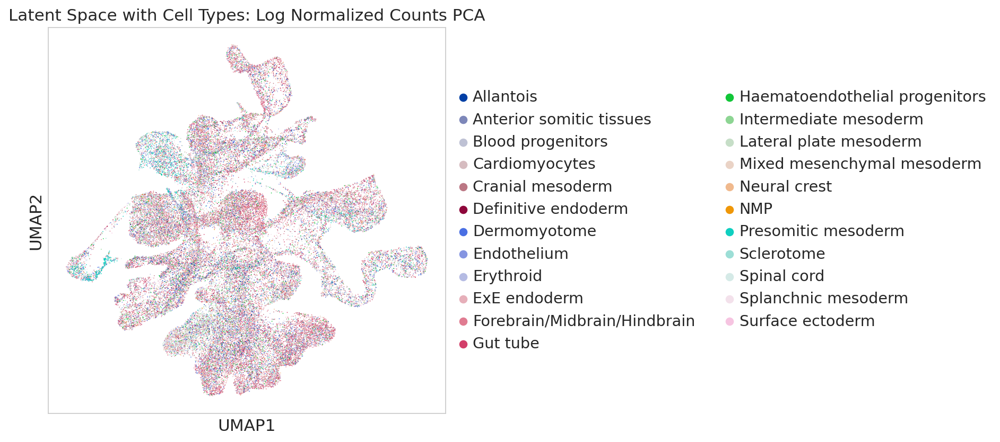

In [74]:
# Run PCA on log normalized counts, then generate UMAP plot with cell type annotations
sc.tl.pca(adata_imputed)
sc.pp.neighbors(adata_imputed, n_pcs=50)
sc.tl.umap(adata_imputed)
fig = sc.pl.umap(adata_imputed,
                 color=[cell_type_key],
                 title="Latent Space with Cell Types: Log Normalized Counts PCA",
                 return_fig=True)

In [75]:
adata_imputed.obs_names

Index(['embryo1_Pos0_cell100_z2', 'embryo1_Pos0_cell101_z2',
       'embryo1_Pos0_cell102_z2', 'embryo1_Pos0_cell103_z2',
       'embryo1_Pos0_cell105_z2', 'embryo1_Pos0_cell106_z2',
       'embryo1_Pos0_cell107_z2', 'embryo1_Pos0_cell109_z2',
       'embryo1_Pos0_cell110_z2', 'embryo1_Pos0_cell111_z2',
       ...
       'embryo3_Pos39_cell83_z5', 'embryo3_Pos39_cell85_z5',
       'embryo3_Pos39_cell87_z5', 'embryo3_Pos39_cell88_z5',
       'embryo3_Pos39_cell9_z5', 'embryo3_Pos39_cell90_z5',
       'embryo3_Pos39_cell93_z5', 'embryo3_Pos39_cell95_z5',
       'embryo3_Pos39_cell96_z5', 'embryo3_Pos39_cell98_z5'],
      dtype='object', length=52568)

In [71]:
adata_imputed.X.toarray()[0,0:10]

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 2.134034  , 0.90518177, 0.        , 0.8263883 ],
      dtype=float32)

In [65]:
adata_imputed.layers["counts"] = np.exp(adata_imputed.X.toarray())

In [66]:
adata_imputed.layers["counts"]

array([[1.       , 1.       , 1.       , ..., 1.4800663, 1.       ,
        1.       ],
       [1.       , 1.       , 1.       , ..., 1.360765 , 1.       ,
        1.       ],
       [1.       , 1.       , 1.       , ..., 2.072468 , 1.       ,
        1.       ],
       ...,
       [1.       , 1.       , 1.       , ..., 1.2575127, 1.       ,
        1.       ],
       [1.       , 1.       , 1.       , ..., 1.3791516, 1.       ,
        1.0377983],
       [1.       , 1.       , 1.       , ..., 1.3921136, 1.       ,
        1.0377983]], dtype=float32)

In [62]:
adata_imputed.var_names

Index(['Xkr4', 'Gm1992', 'Gm37381', 'Rp1', 'Sox17', 'Gm37323', 'Mrpl15',
       'Lypla1', 'Gm37988', 'Tcea1',
       ...
       'AC125149.1', 'AC125149.2', 'AC125149.4', 'AC234645.1', 'AC168977.2',
       'AC168977.1', 'AC149090.1', 'DHRSX', 'Vmn2r122', 'CAAA01147332.1'],
      dtype='object', length=29452)

In [43]:
adata_test = adata_imputed[:, adata_imputed.var_names.isin(['Abcc4', 'Acp5', 'Acvr1', 'Acvr2a', 'Adora2b'])]

In [72]:
adata_test.X.toarray()[0,0:10]

array([0.        , 0.        , 0.03470533, 0.15205581, 0.00054838],
      dtype=float32)

In [49]:
adata_test_2 = adata[:, adata.var_names.isin(['Abcc4', 'Acp5', 'Acvr1', 'Acvr2a', 'Adora2b'])]

In [58]:
adata_test_2.X.toarray()

array([[0.        , 2.1981418 , 0.        , 0.        , 0.        ],
       [0.        , 1.482559  , 0.        , 1.482559  , 0.        ],
       [0.        , 0.        , 0.2861589 , 0.        , 0.2861589 ],
       ...,
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.        , 0.        , 0.        , 0.        ],
       [0.        , 0.84200865, 0.        , 0.        , 0.        ]],
      dtype=float32)

In [57]:
adata_test_2.obs_names

Index(['embryo1_Pos0_cell100_z2', 'embryo1_Pos0_cell101_z2',
       'embryo1_Pos0_cell102_z2', 'embryo1_Pos0_cell105_z2',
       'embryo1_Pos0_cell106_z2', 'embryo1_Pos0_cell107_z2',
       'embryo1_Pos0_cell108_z2', 'embryo1_Pos0_cell109_z2',
       'embryo1_Pos0_cell11_z2', 'embryo1_Pos0_cell110_z2',
       ...
       'embryo3_Pos39_cell83_z5', 'embryo3_Pos39_cell85_z5',
       'embryo3_Pos39_cell87_z5', 'embryo3_Pos39_cell88_z5',
       'embryo3_Pos39_cell9_z5', 'embryo3_Pos39_cell90_z5',
       'embryo3_Pos39_cell91_z5', 'embryo3_Pos39_cell93_z5',
       'embryo3_Pos39_cell96_z5', 'embryo3_Pos39_cell98_z5'],
      dtype='object', length=52568)

In [41]:
adata.var_names

Index(['Abcc4', 'Acp5', 'Acvr1', 'Acvr2a', 'Adora2b', 'Afp', 'Ahnak',
       'Akr1c19', 'Alas2', 'Aldh1a2',
       ...
       'Wnt2b', 'Wnt3', 'Wnt3a', 'Wnt5a', 'Wnt5b', 'Wnt8a', 'Xist', 'Zfp444',
       'Zfp57', 'Zic3'],
      dtype='object', length=351)

In [79]:
adata_batch1 = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_{batch1}.h5ad")
adata_batch2 = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_{batch2}.h5ad")
adata_batch3 = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_{batch3}.h5ad")
adata_batch4 = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_{batch4}.h5ad")
adata_batch5 = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_{batch5}.h5ad")
adata_batch6 = ad.read_h5ad(f"{srt_data_gold_folder_path}/{dataset}_{batch6}.h5ad")

adata_batch_list = [adata_batch1,
                    adata_batch2,
                    adata_batch3,
                    adata_batch4,
                    adata_batch5,
                    adata_batch6]

In [10]:
for adata_batch in adata_batch_list:
    # Compute (separate) spatial neighborhood
    sq.gr.spatial_neighbors(adata_batch,
                            coord_type="generic",
                            spatial_key=spatial_key,
                            n_neighs=n_neighbors)
    # Make adjacency matrix symmetric
    adata_batch.obsp["spatial_connectivities"] = adata_batch.obsp["spatial_connectivities"].maximum(
        adata_batch.obsp["spatial_connectivities"].T)

### 2.2 Combine Data for One-Shot Batch Integration

In [11]:
adata = ad.concat(adata_batch_list, join="inner")

# Combine spatial neighborhood graphs as disconnected components
connectivities_extension_batch1 = sp.csr_matrix((adata_batch1.shape[0],
                                                 (adata_batch2.shape[0] +
                                                  adata_batch3.shape[0] +
                                                  adata_batch4.shape[0] +
                                                  adata_batch5.shape[0] +
                                                  adata_batch6.shape[0])))
connectivities_extension_batch2_before = sp.csr_matrix((adata_batch2.shape[0],
                                                        adata_batch1.shape[0]))
connectivities_extension_batch2_after = sp.csr_matrix((adata_batch2.shape[0],
                                                       (adata_batch3.shape[0] +
                                                        adata_batch4.shape[0] +
                                                        adata_batch5.shape[0] +
                                                        adata_batch6.shape[0])))
connectivities_extension_batch3_before = sp.csr_matrix((adata_batch3.shape[0],
                                                        (adata_batch1.shape[0] +
                                                         adata_batch2.shape[0])))
connectivities_extension_batch3_after = sp.csr_matrix((adata_batch3.shape[0],
                                                       (adata_batch4.shape[0] +
                                                        adata_batch5.shape[0] +
                                                        adata_batch6.shape[0])))
connectivities_extension_batch4_before = sp.csr_matrix((adata_batch4.shape[0],
                                                        (adata_batch1.shape[0] +
                                                         adata_batch2.shape[0] +
                                                         adata_batch3.shape[0])))
connectivities_extension_batch4_after = sp.csr_matrix((adata_batch4.shape[0],
                                                       (adata_batch5.shape[0] +
                                                        adata_batch6.shape[0])))
connectivities_extension_batch5_before = sp.csr_matrix((adata_batch5.shape[0],
                                                        (adata_batch1.shape[0] +
                                                         adata_batch2.shape[0] +
                                                         adata_batch3.shape[0] +
                                                         adata_batch4.shape[0])))
connectivities_extension_batch5_after = sp.csr_matrix((adata_batch5.shape[0],
                                                       adata_batch6.shape[0]))
connectivities_extension_batch6 = sp.csr_matrix((adata_batch6.shape[0],
                                                 (adata_batch1.shape[0] +
                                                  adata_batch2.shape[0] +
                                                  adata_batch3.shape[0] +
                                                  adata_batch4.shape[0] +
                                                  adata_batch5.shape[0])))

connectivities_batch1 = sp.hstack((adata_batch1.obsp["spatial_connectivities"],
                                   connectivities_extension_batch1))
connectivities_batch2 = sp.hstack((connectivities_extension_batch2_before,
                                   adata_batch2.obsp["spatial_connectivities"],
                                   connectivities_extension_batch2_after))
connectivities_batch3 = sp.hstack((connectivities_extension_batch3_before,
                                   adata_batch3.obsp["spatial_connectivities"],
                                   connectivities_extension_batch3_after))
connectivities_batch4 = sp.hstack((connectivities_extension_batch4_before,
                                   adata_batch4.obsp["spatial_connectivities"],
                                   connectivities_extension_batch4_after))
connectivities_batch5 = sp.hstack((connectivities_extension_batch5_before,
                                   adata_batch5.obsp["spatial_connectivities"],
                                   connectivities_extension_batch5_after))
connectivities_batch6 = sp.hstack((connectivities_extension_batch6,
                                   adata_batch6.obsp["spatial_connectivities"]))

connectivities = sp.vstack((connectivities_batch1,
                            connectivities_batch2,
                            connectivities_batch3,
                            connectivities_batch4,
                            connectivities_batch5,
                            connectivities_batch6))

adata.obsp["spatial_connectivities"] = connectivities

### 2.2 Explore Data

In [ ]:
print(f"Using dataset {dataset}_imputed.")
print(f"Number of nodes (cells): {adata.X.shape[0]}")
print(f"Number of node features (genes): {adata.X.shape[1]}")

for adata_batch in adata_batch_list:
    # Visualize cell-level annotated data in spatial space
    sq.pl.spatial_scatter(adata_batch, color=cell_type_key, shape=None, figsize=(12, 12))

In [ ]:
# Plot histogram of node counts per number of neighbors
ax = sns.histplot(np.squeeze(np.asarray(adata.obsp['spatial_connectivities'].sum(axis=0))),
                  discrete=True)
ax.set_title("Node Counts Per Number of Neighbors")
ax.set_ylabel("Node Count")
ax.set_xlabel("Number of Neighbors")
fig = ax.figure
fig.savefig(f"{figure_folder_path}/node_counts_per_n_neighs.png",
            bbox_inches="tight")
plt.show()

avg_edges_per_node = round(adata.obsp['spatial_connectivities'].sum(axis=0).mean(), 2)
print(f"Average number of edges per node: {avg_edges_per_node}.")
n_edges = int(sp.triu(adata.obsp['spatial_connectivities'], k=1).sum())
print(f"Number of total edges: {n_edges}.")

## 3. Autotalker Model with Prior Knowledge Cell-Cell-Interaction (CCI) Gene Programs (GPs)

### 3.1 Prepare Prior Knowledge CCI GP Mask

In [12]:
nichenet_gp_dict = extract_gp_dict_from_nichenet_ligand_target_mx(
    keep_target_ratio=0.01,
    load_from_disk=True,
    save_to_disk=False,
    file_path=nichenet_ligand_target_mx_file_path)

In [13]:
omnipath_gp_dict = extract_gp_dict_from_omnipath_lr_interactions(
    min_curation_effort=0,
    load_from_disk=False,
    save_to_disk=True,
    file_path=omnipath_lr_interactions_file_path)

In [14]:
mebocost_gp_dict = extract_gp_dict_from_mebocost_es_interactions(
    dir_path=f"{gp_data_folder_path}/metabolite_enzyme_sensor_gps/",
    species="mouse",
    genes_uppercase=True)

In [15]:
# Combine gene programs into one dictionary
combined_gp_dict = dict(nichenet_gp_dict)
combined_gp_dict.update(omnipath_gp_dict)
combined_gp_dict.update(mebocost_gp_dict)

In [16]:
# Filter and combine gene programs
combined_new_gp_dict = filter_and_combine_gp_dict_gps(
    gp_dict=combined_gp_dict,
    gp_filter_mode="subset",
    combine_overlap_gps=True,
    overlap_thresh_source_genes=0.9,
    overlap_thresh_target_genes=0.9,
    overlap_thresh_genes=0.9,
    verbose=True)

print(f"Number of gene programs before filtering and combining: {len(combined_gp_dict)}.")
print(f"Number of gene programs after filtering and combining: {len(combined_new_gp_dict)}.")

Removing GP 'CTF1_ligand_receptor_GP' as it is a subset of GP 'CTF1_ligand_targetgenes_GP'.
Removing GP 'LEP_ligand_receptor_GP' as it is a subset of GP 'LEP_ligand_targetgenes_GP'.
Removing GP 'IL4_ligand_receptor_GP' as it is a subset of GP 'IL4_ligand_targetgenes_GP'.
Removing GP 'IL12A_ligand_receptor_GP' as it is a subset of GP 'IL12A_ligand_targetgenes_GP'.
Removing GP 'IL23A_ligand_receptor_GP' as it is a subset of GP 'IL23A_ligand_targetgenes_GP'.
Removing GP 'CSF2_ligand_receptor_GP' as it is a subset of GP 'CSF2_ligand_targetgenes_GP'.
Removing GP 'IL21_ligand_receptor_GP' as it is a subset of GP 'IL21_ligand_targetgenes_GP'.
Removing GP 'TSLP_ligand_receptor_GP' as it is a subset of GP 'TSLP_ligand_targetgenes_GP'.
Removing GP 'GH2_ligand_receptor_GP' as it is a subset of GP 'GH2_ligand_targetgenes_GP'.
Removing GP 'EGF_ligand_receptor_GP' as it is a subset of GP 'EGF_ligand_targetgenes_GP'.
Removing GP 'IL10_ligand_receptor_GP' as it is a subset of GP 'IL10_ligand_targetgen

In [17]:
# Add the gene program dictionary as binary masks to the adata for model training
add_gps_from_gp_dict_to_adata(
    gp_dict=combined_new_gp_dict,
    adata=adata,
    genes_uppercase=True,
    gp_targets_mask_key="autotalker_gp_targets",
    gp_sources_mask_key="autotalker_gp_sources",
    gp_names_key="autotalker_gp_names",
    min_genes_per_gp=1,
    min_source_genes_per_gp=0,
    min_target_genes_per_gp=0,
    max_genes_per_gp=None,
    max_source_genes_per_gp=None,
    max_target_genes_per_gp=None,
    filter_genes_not_in_masks=False)

# Determine dimensionality of hidden encoder
n_hidden_encoder = len(adata.uns["autotalker_gp_names"])

In [18]:
# Summarize gene programs
print(f"Number of gene programs with probed genes: {len(adata.uns['autotalker_gp_names'])}.")
print(f"Example gene programs: {random.sample(list(adata.uns['autotalker_gp_names']), 5)}.")
print(f"Number of gene program target genes: {adata.varm['autotalker_gp_targets'].sum()}.")
print(f"Number of gene program source genes: {adata.varm['autotalker_gp_sources'].sum()}.")

Number of gene programs with probed genes: 489.
Example gene programs: ['ADM_ligand_receptor_GP', 'NTF3_ligand_targetgenes_GP', 'TFF1_ligand_targetgenes_GP', 'FGF9_ligand_targetgenes_GP', 'L-Lactic acid_metabolite_enzyme_sensor_GP'].
Number of gene program target genes: 7476.
Number of gene program source genes: 127.


### 3.2 Initialize, Train & Save Model

In [19]:
# Initialize model
model = Autotalker(adata,
                   counts_key=counts_key,
                   adj_key=adj_key,
                   condition_key=condition_key,
                   cond_embed_injection=["encoder",
                                         "gene_expr_decoder",
                                         "graph_decoder"],
                   n_cond_embed=n_cond_embed,
                   gp_names_key=gp_names_key,
                   active_gp_names_key=active_gp_names_key,
                   gp_targets_mask_key=gp_targets_mask_key,
                   gp_sources_mask_key=gp_sources_mask_key,
                   latent_key=latent_key,
                   active_gp_thresh_ratio=active_gp_thresh_ratio,
                   gene_expr_recon_dist=gene_expr_recon_dist,
                   n_hidden_encoder=n_hidden_encoder,
                   n_addon_gps=0,
                   node_label_method="one-hop-attention")

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, gene_expr_recon_dist: nb
NODE LABEL METHOD -> one-hop-attention
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CONDITIONAL EMBEDDING INJECTION -> ['encoder', 'gene_expr_decoder', 'graph_decoder']
GRAPH ENCODER -> n_input: 351, n_cond_embed_input: 3, n_hidden: 489, n_latent: 489, n_addon_latent: 0, conv_layer: gcnconv, n_attention_heads: 0, dropout_rate: 0.0
DOT PRODUCT GRAPH DECODER -> n_cond_embed_input: 3, n_output: 489, dropout_rate: 0.0
MASKED GENE EXPRESSION DECODER -> n_input: 489, n_cond_embed_input: 3, n_addon_input: 0, n_output: 702


In [20]:
# Train model
model.train(n_epochs,
            n_epochs_all_gps=n_epochs_all_gps,
            lr=lr,
            lambda_edge_recon=lambda_edge_recon,
            lambda_gene_expr_recon=lambda_gene_expr_recon,
            verbose=True)

--- INITIALIZING TRAINER ---
Number of training nodes: 47311
Number of validation nodes: 5257
Number of training edges: 109836
Number of validation edges: 12204

--- MODEL TRAINING ---
Epoch 1/40 |--------------------| 2.5% val_auroc_score: 0.9439; val_auprc_score: 0.9017; val_best_acc_score: 0.7831; val_best_f1_score: 0.8217; train_kl_reg_loss: 0.0115; train_edge_recon_loss: 0.0255; train_gene_expr_recon_loss: 0.5838; train_group_lasso_reg_loss: 0.0000; train_global_loss: 0.6209; train_optim_loss: 0.6209; val_kl_reg_loss: 0.0089; val_edge_recon_loss: 0.0161; val_gene_expr_recon_loss: 0.5389; val_group_lasso_reg_loss: 0.0000; val_global_loss: 0.5639; val_optim_loss: 0.5639
Epoch 2/40 |█-------------------| 5.0% val_auroc_score: 0.9649; val_auprc_score: 0.9368; val_best_acc_score: 0.8534; val_best_f1_score: 0.8721; train_kl_reg_loss: 0.0134; train_edge_recon_loss: 0.0184; train_gene_expr_recon_loss: 0.5236; train_group_lasso_reg_loss: 0.0000; train_global_loss: 0.5555; train_optim_loss:

In [21]:
# Save trained model
model.save(dir_path=model_artifacts_folder_path + "/prior_knowledge_gp_mask",
           overwrite=True,
           save_adata=True,
           adata_file_name=f"{dataset}.h5ad")

## 4. Analysis

### 4.1 Load Model

In [22]:
# Load trained model
if load_timestamp is not None:
    model_artifacts_load_folder_path = f"../artifacts/{dataset}/analysis/{load_timestamp}"
else:
    model_artifacts_load_folder_path = model_artifacts_folder_path
    
model = Autotalker.load(dir_path=f"{model_artifacts_load_folder_path}/prior_knowledge_gp_mask",
                        adata=None,
                        adata_file_name=f"{dataset}.h5ad",
                        gp_names_key="autotalker_gp_names")

--- INITIALIZING NEW NETWORK MODULE: VARIATIONAL GENE PROGRAM GRAPH AUTOENCODER ---
LOSS -> include_edge_recon_loss: True, include_gene_expr_recon_loss: True, gene_expr_recon_dist: nb
NODE LABEL METHOD -> one-hop-attention
ACTIVE GP THRESHOLD RATIO -> 0.03
LOG VARIATIONAL -> True
CONDITIONAL EMBEDDING INJECTION -> ['encoder', 'gene_expr_decoder', 'graph_decoder']
GRAPH ENCODER -> n_input: 351, n_cond_embed_input: 3, n_hidden: 489, n_latent: 489, n_addon_latent: 0, conv_layer: gcnconv, n_attention_heads: 0, dropout_rate: 0.0
DOT PRODUCT GRAPH DECODER -> n_cond_embed_input: 3, n_output: 489, dropout_rate: 0.0
MASKED GENE EXPRESSION DECODER -> n_input: 489, n_cond_embed_input: 3, n_addon_input: 0, n_output: 702


In [23]:
# Check number of active gene programs
active_gps = model.get_active_gps()
print(f"Number of total gene programs: {len(model.adata.uns[gp_names_key])}.")
print(f"Number of active gene programs: {len(active_gps)}.")

Number of total gene programs: 489.
Number of active gene programs: 112.


In [24]:
# Use Autotalker latent space for UMAP generation
sc.pp.neighbors(model.adata, use_rep=latent_key, key_added=latent_key)
sc.tl.umap(model.adata, neighbors_key=latent_key)

### 4.1 Cell Types in Spatial and Physical Space

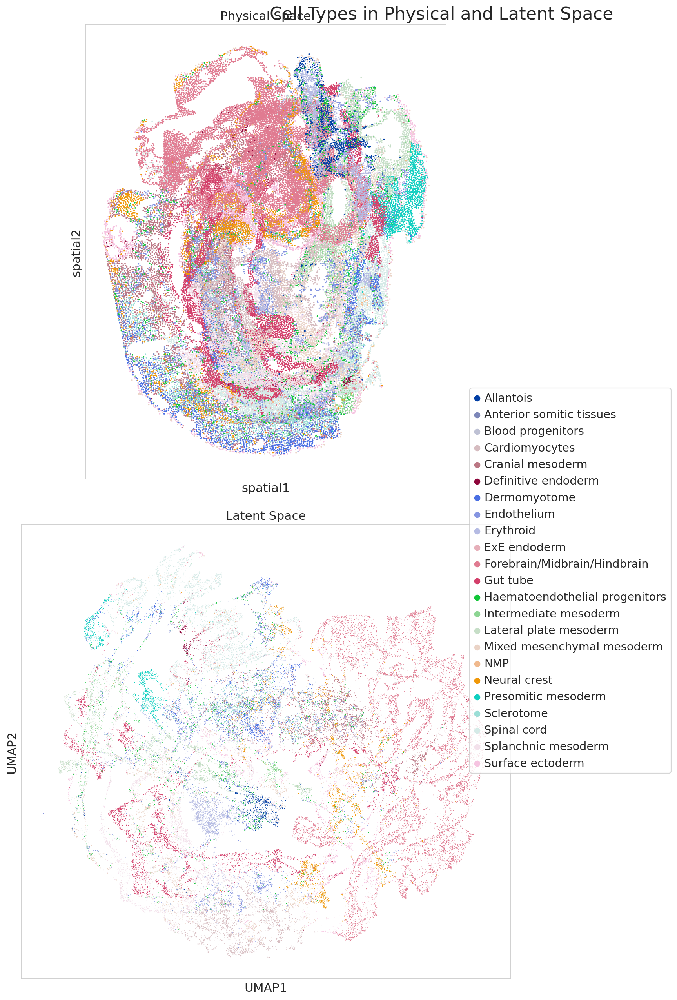

In [26]:
# Create subplot of cell-type annotations in physical and latent space
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(10, 20))
title = fig.suptitle(t="Cell Types in Physical and Latent Space",
                     x=0.85,
                     y=0.925,
                     fontsize=20)
sc.pl.spatial(adata=model.adata,
              color=[cell_type_key],
              spot_size=0.03,
              title="Physical Space",
              ax=axs[0],
              show=False)
sc.pl.umap(adata=model.adata,
           color=[cell_type_key],
           title="Latent Space",
           ax=axs[1],
           show=False)

# Create and position shared legend
handles, labels = axs[0].get_legend_handles_labels()
lgd = fig.legend(handles, labels, bbox_to_anchor=(1.225, 0.625))
axs[0].get_legend().remove()
axs[1].get_legend().remove()

# Adjust, save and display plot
plt.subplots_adjust(wspace=0, hspace=0.1)
fig.savefig(f"{figure_folder_path}/cell_types_physical_latent_space.png",
            bbox_extra_artists=(lgd, title),
            bbox_inches="tight")
plt.show()

### 4.2 Latent Leiden Clusters in Latent and Physical Space

In [27]:
# Compute latent Leiden clustering
resolution = 0.3

sc.tl.leiden(adata=model.adata,
             resolution=resolution,
             random_state=random_seed,
             key_added=f"latent_leiden_{str(resolution)}",
             adjacency=model.adata.obsp[f"{latent_key}_connectivities"])

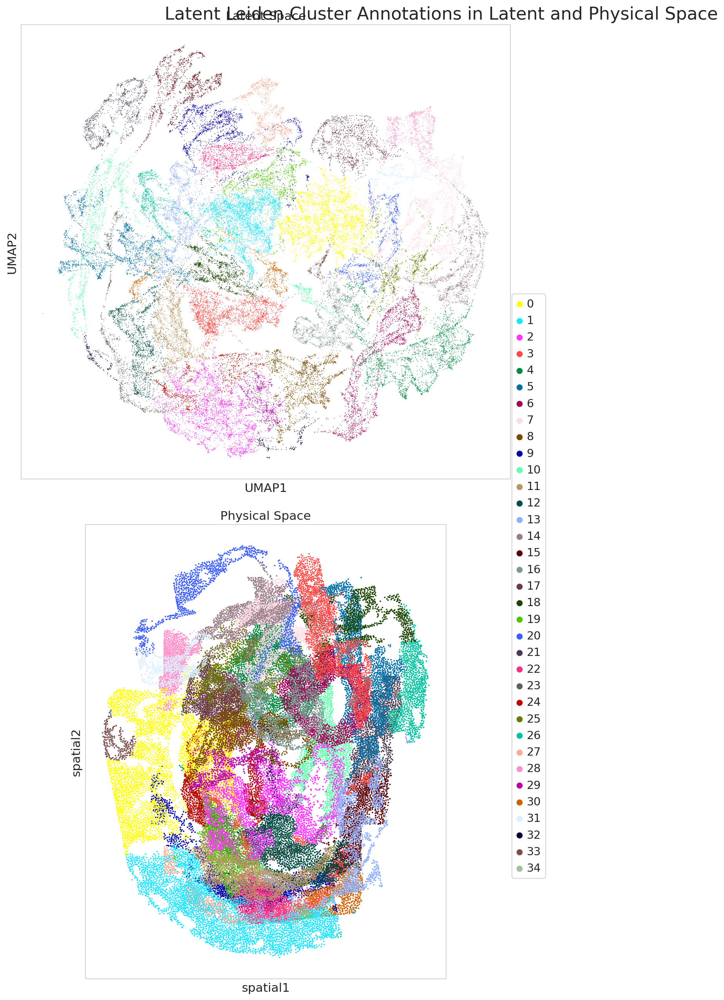

In [28]:
# Create subplot of latent Leiden cluster annotations in physical and latent space
fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(10, 20))
title = fig.suptitle(t="Latent Leiden Cluster Annotations in Latent and Physical Space",
                     x=0.85,
                     y=0.925,
                     fontsize=20)
sc.pl.umap(adata=model.adata,
           color=[f"latent_leiden_{str(resolution)}"],
           title=f"Latent Space",
           ax=axs[0],
           show=False)
sc.pl.spatial(adata=model.adata,
              color=[f"latent_leiden_{str(resolution)}"],
              spot_size=0.03,
              title=f"Physical Space",
              ax=axs[1],
              show=False)

# Create and position shared legend
handles, labels = axs[0].get_legend_handles_labels()
lgd = fig.legend(handles, labels, bbox_to_anchor=(1.025, 0.7))
axs[0].get_legend().remove()
axs[1].get_legend().remove()

# Adjust, save and display plot
plt.subplots_adjust(wspace=0, hspace=0.1)
fig.savefig(f"{figure_folder_path}/latent_leiden_clusters_latent_physical_space.png",
            bbox_extra_artists=(lgd, title),
            bbox_inches="tight")
plt.show()

### 4.3 GP Enrichments

#### 4.3.1 Cell-type GP Enrichments

In [29]:
differential_gp_scores_key = "autotalker_cell_type_differential_gp_scores"
n_top_up_gps = 10
n_top_down_gps = 10

##### 4.3.1.1 Explore All GPs Across All Categories

In [30]:
# Compute gene program enrichments and retrieve top up- and downregulated gene programs
top_unique_gps = model.compute_differential_gp_scores(cat_key=cell_type_key,
                                                      adata=model.adata,
                                                      selected_gps=None, # ["BMP7_ligand_targetgenes_GP", "CD24_ligand_targetgenes_GP"],
                                                      selected_cats=None, # ["Cardiomyocytes", "Presomitic mesoderm"]
                                                      gp_scores_weight_normalization=False,
                                                      comparison_cats="rest",
                                                      n_sample=10000,
                                                      key_added=differential_gp_scores_key,
                                                      n_top_up_gps_retrieved=n_top_up_gps,
                                                      n_top_down_gps_retrieved=n_top_down_gps,
                                                      seed=random_seed)

In [33]:
# Display top upregulated gene programs
top_up_gp_df = model.adata.uns[differential_gp_scores_key][:n_top_up_gps]
display(top_up_gp_df)

,category,gene_program,p_h0,p_h1,log_bayes_factor
0,Erythroid,SECTM1_ligand_targetgenes_GP,0.969729,0.030271,3.466842
1,Cardiomyocytes,CSH1_ligand_targetgenes_GP,0.949374,0.050626,2.931347
2,Erythroid,Glycine_metabolite_enzyme_sensor_GP,0.921562,0.078438,2.463765
3,Presomitic mesoderm,DLL3_ligand_targetgenes_GP,0.920884,0.079116,2.454414
4,Cardiomyocytes,IGF1_ligand_targetgenes_GP,0.904083,0.095917,2.243436
5,Endothelium,IL17C_ligand_targetgenes_GP,0.894670,0.105330,2.139356
6,Erythroid,CRLF1_ligand_targetgenes_GP,0.893491,0.106509,2.126910
7,Blood progenitors,SECTM1_ligand_targetgenes_GP,0.886914,0.113086,2.059596
8,Presomitic mesoderm,TSLP_ligand_targetgenes_GP,0.886365,0.113635,2.054139
9,Presomitic mesoderm,DLL1_ligand_targetgenes_GP,0.881139,0.118861,2.003260


In [34]:
# Display top downregulated gene programs
top_down_gp_df = model.adata.uns[differential_gp_scores_key][-n_top_down_gps:][::-1]
display(top_down_gp_df)

,category,gene_program,p_h0,p_h1,log_bayes_factor
2575,Cardiomyocytes,CDH18_ligand_targetgenes_GP,0.087974,0.912026,-2.338629
2574,Gut tube,IFNL1_ligand_targetgenes_GP,0.107366,0.892634,-2.117938
2573,Splanchnic mesoderm,GDF3_ligand_targetgenes_GP,0.113907,0.886093,-2.051443
2572,Sclerotome,CRLF2_ligand_targetgenes_GP,0.136751,0.863249,-1.842540
2571,Dermomyotome,CRLF2_ligand_targetgenes_GP,0.137083,0.862917,-1.839732
2570,Presomitic mesoderm,CRLF2_ligand_targetgenes_GP,0.158942,0.841058,-1.666123
2569,Erythroid,WISP2_ligand_targetgenes_GP,0.175784,0.824216,-1.545174
2568,Anterior somitic tissues,CRLF2_ligand_targetgenes_GP,0.177318,0.822682,-1.534625
2567,Mixed mesenchymal mesoderm,TSLP_ligand_targetgenes_GP,0.191287,0.808713,-1.441672
2566,Cardiomyocytes,SDK1_ligand_targetgenes_GP,0.196350,0.803650,-1.409267


         Falling back to preprocessing with `sc.pp.pca` and default params.


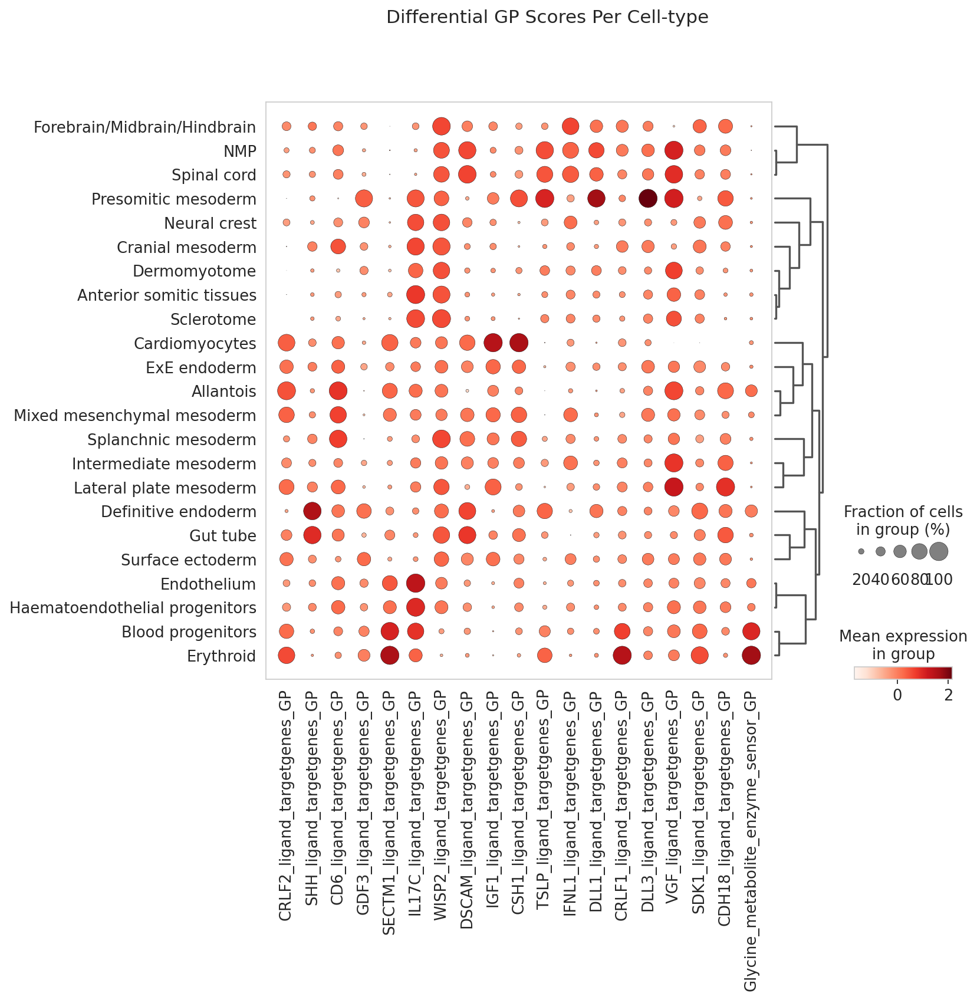

In [35]:
fig = sc.pl.dotplot(model.adata,
                    top_unique_gps,
                    groupby=cell_type_key,
                    dendrogram=True, 
                    title="Differential GP Scores Per Cell-type",
                    return_fig=True)

# Save and display plot
fig.savefig(f"{figure_folder_path}/differential_gp_scores_per_cell_type_all_categories.png")
plt.show()

In [36]:
top_cats = top_up_gp_df["category"].append(top_down_gp_df["category"]).to_list()
top_gps = top_up_gp_df["gene_program"].append(top_down_gp_df["gene_program"]).to_list()
top_genes = []

for gp in top_gps:
    top_genes.append(
        model.compute_gp_gene_importances(selected_gp=gp)["gene"][0])

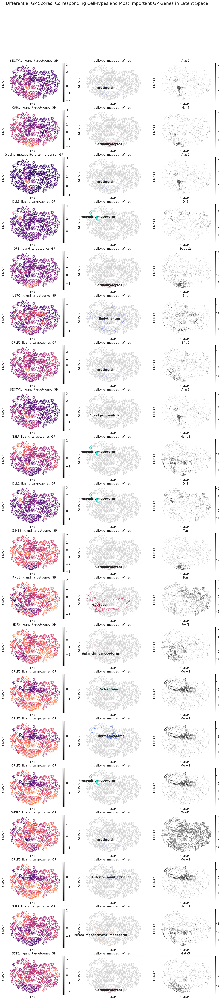

In [37]:
# Plot selected gene program latent scores
fig, axs = plt.subplots(nrows=n_top_up_gps+n_top_down_gps, ncols=3, figsize=(18, 4*len(top_gps)))
title = fig.suptitle(t="Differential GP Scores, Corresponding Cell-Types and Most Important GP Genes in Latent Space",
                     x=0.55,
                     y=0.96,
                     fontsize=20)
for i in range(len(top_gps)):
    sc.pl.umap(model.adata, color=top_gps[i], color_map="magma", ax=axs[i, 0], show=False)
    sc.pl.umap(model.adata,
               color=[cell_type_key],
               color_map="magma",
               groups=top_cats[i],
               ax=axs[i, 1],
               legend_loc="on data",
               na_in_legend=False,
               show=False)
    sc.pl.umap(model.adata,
               color=top_genes[i],
               color_map="binary",
               ax=axs[i, 2],
               legend_loc="on data",
               na_in_legend=False,
               show=False)
    
# Save and display plot
fig.savefig(f"{figure_folder_path}/cell_type_gp_scores_cell_types_most_important_genes_all_categories.png",
            bbox_extra_artists=(title,),
            bbox_inches="tight")
plt.show()

##### 4.3.1.2 Explore All GPs Across Specific Categories

In [ ]:
selected_cats = ["Erythroid", "Cardiomyocytes"]

In [ ]:
# Compute gene program enrichments and retrieve top up- and downregulated gene programs
top_unique_gps = model.compute_differential_gp_scores(cat_key=cell_type_key,
                                                      adata=model.adata,
                                                      selected_gps=None,
                                                      selected_cats=selected_cats,
                                                      gp_scores_weight_normalization=False,
                                                      comparison_cats="rest",
                                                      n_sample=1000,
                                                      key_added=differential_gp_scores_key,
                                                      n_top_up_gps_retrieved=n_top_up_gps,
                                                      n_top_down_gps_retrieved=n_top_down_gps,
                                                      seed=random_seed)

In [ ]:
# Display top upregulated gene programs
top_up_gp_df = model.adata.uns[differential_gp_scores_key][:n_top_up_gps]
display(top_up_gp_df)

In [ ]:
# Display top downregulated gene programs
top_down_gp_df = model.adata.uns[differential_gp_scores_key][-n_top_down_gps:][::-1]
display(top_down_gp_df)

In [ ]:
fig = sc.pl.dotplot(model.adata,
                    top_unique_gps,
                    groupby=cell_type_key,
                    dendrogram=True, 
                    title="Differential GP Scores Per Cell-type",
                    return_fig=True)

# Save and display plot
fig.savefig(f"{figure_path}/differential_gp_scores_per_cell_type_specific_categories.png")
plt.show()

In [ ]:
top_cats = top_up_gp_df["category"].append(top_down_gp_df["category"]).to_list()
top_gps = top_up_gp_df["gene_program"].append(top_down_gp_df["gene_program"]).to_list()
top_genes = []

for gp in top_gps:
    top_genes.append(
        model.compute_gp_gene_importances(selected_gp=gp)["gene"][0])

In [ ]:
# Plot selected gene program latent scores
fig, axs = plt.subplots(nrows=n_top_up_gps+n_top_down_gps, ncols=3, figsize=(18, 4*len(top_gps)))
title = fig.suptitle(t="Differential GP Scores, Corresponding Cell-Types and Most Important GP Genes in Latent Space",
                     x=0.55,
                     y=0.96,
                     fontsize=20)
for i in range(len(top_gps)):
    sc.pl.umap(model.adata, color=top_gps[i], color_map="magma", ax=axs[i, 0], show=False)
    sc.pl.umap(model.adata,
               color=[cell_type_key],
               color_map="magma",
               groups=top_cats[i],
               ax=axs[i, 1],
               legend_loc="on data",
               na_in_legend=False,
               show=False)
    sc.pl.umap(model.adata,
               color=top_genes[i],
               color_map="binary",
               ax=axs[i, 2],
               legend_loc="on data",
               na_in_legend=False,
               show=False)
    
# Save and display plot
fig.savefig(f"{figure_path}/cell_type_gp_scores_cell_types_most_important_genes_specific_categories.png",
            bbox_extra_artists=(title,),
            bbox_inches="tight")
plt.show()

##### 4.3.1.3 Explore Specific GPs

In [ ]:
selected_gps = ["BMP7_ligand_targetgenes_GP", "EPOR_ligand_receptor_GP"]

In [ ]:
# Compute gene program enrichments and retrieve top up- and downregulated gene programs
top_unique_gps = model.compute_differential_gp_scores(cat_key=cell_type_key,
                                                      adata=model.adata,
                                                      selected_gps=selected_gps,
                                                      selected_cats=None,
                                                      gp_scores_weight_normalization=False,
                                                      comparison_cats="rest",
                                                      n_sample=1000,
                                                      key_added=differential_gp_scores_key,
                                                      n_top_up_gps_retrieved=n_top_up_gps,
                                                      n_top_down_gps_retrieved=n_top_down_gps,
                                                      seed=random_seed)

In [ ]:
# Display top upregulated gene programs
top_up_gp_df = model.adata.uns[differential_gp_scores_key][:n_top_up_gps]
display(top_up_gp_df)

In [ ]:
# Display top downregulated gene programs
top_down_gp_df = model.adata.uns[differential_gp_scores_key][-n_top_down_gps:][::-1]
display(top_down_gp_df)

In [ ]:
fig = sc.pl.dotplot(model.adata,
                    top_unique_gps,
                    groupby=cell_type_key,
                    dendrogram=True, 
                    title="Differential GP Scores Per Cell-type",
                    return_fig=True)

# Save and display plot
fig.savefig(f"{figure_path}/differential_gp_scores_per_cell_type_specific_gps.png")
plt.show()

In [ ]:
top_cats = top_up_gp_df["category"].append(top_down_gp_df["category"]).to_list()
top_gps = top_up_gp_df["gene_program"].append(top_down_gp_df["gene_program"]).to_list()
top_genes = []

for gp in top_gps:
    top_genes.append(
        model.compute_gp_gene_importances(selected_gp=gp)["gene"][0])

In [ ]:
# Plot selected gene program latent scores
fig, axs = plt.subplots(nrows=n_top_up_gps+n_top_down_gps, ncols=3, figsize=(18, 4*len(top_gps)))
title = fig.suptitle(t="Differential GP Scores, Corresponding Cell-Types and Most Important GP Genes in Latent Space",
                     x=0.55,
                     y=0.96,
                     fontsize=20)
for i in range(len(top_gps)):
    sc.pl.umap(model.adata, color=top_gps[i], color_map="magma", ax=axs[i, 0], show=False)
    sc.pl.umap(model.adata,
               color=[cell_type_key],
               color_map="magma",
               groups=top_cats[i],
               ax=axs[i, 1],
               legend_loc="on data",
               na_in_legend=False,
               show=False)
    sc.pl.umap(model.adata,
               color=top_genes[i],
               color_map="binary",
               ax=axs[i, 2],
               legend_loc="on data",
               na_in_legend=False,
               show=False)
    
# Save and display plot
fig.savefig(f"{figure_path}/cell_type_gp_scores_cell_types_most_important_genes_specific_gps.png",
            bbox_extra_artists=(title,),
            bbox_inches="tight")
plt.show()

#### 4.3.2 Spatial GP Enrichments

Same analysis can be done with spatial cluster labels instead of cell-types.

#### 4.3.3 GP Gene Importances

In [ ]:
selected_gp = ["BMP7_ligand_targetgenes_GP"]

In [ ]:
gene_importances_df = model.compute_gp_gene_importances(
    selected_gp="BMP7_ligand_receptor_GP",
    adata=None)

display(gene_importances_df)

In [ ]:
genes = list(gene_importances_df["gene"])

for gene in genes:
    sc.pl.umap(model.adata,
               color=gene,
               color_map="binary",
               legend_loc="on data",
               na_in_legend=False)

## 5. Learn De-Novo CCI GPs

### 5.1 Initialize, Train & Save Model

In [ ]:
model = Autotalker.load(dir_path=f"{model_artifacts_path}/autotalker_combined_gps_{current_timestamp}",
                        adata=None,
                        adata_file_name=f"{dataset}.h5ad",
                        n_addon_gps=10,
                        gp_names_key=gp_names_key,
                        freeze_non_addon_weights=True)

In [ ]:
model.train(n_epochs=n_epochs,
            n_epochs_all_gps=n_epochs_all_gps,
            lr=lr,
            lambda_l1_addon=lambda_l1_addon)

In [ ]:
model.save(dir_path=f"{model_artifacts_path}/autotalker_combined_denovo_gps_{current_timestamp}",
           overwrite=True,
           save_adata=True,
           adata_file_name=f"{dataset}.h5ad")

In [ ]:
# Use log normalized counts as raw counts are not available
adata.layers["log_normalized_counts"] = adata.X

# Keep only highly variable genes
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=2000,
    batch_key="batch",
    subset=True)

Same analysis can be repeated with de-novo gene programs.